## INFO411 - Assignment 2

In [1]:
# import Pkg; Pkg.add("CSV")
# import Pkg; Pkg.add("DataFrames")
# import Pkg; Pkg.add("Plots")
using CSV, DataFrames, Plots

Load the MITBIH_Train dataset

In [2]:
df = CSV.read("mitbih_train.csv", DataFrame, header=0)

,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.977941,0.926471,0.681373,0.245098,0.154412,0.191176,0.151961,0.0857843
2,0.960114,0.863248,0.461538,0.196581,0.0940171,0.125356,0.0997151,0.0883191
3,1.0,0.659459,0.186486,0.0702703,0.0702703,0.0594595,0.0567568,0.0432432
4,0.925414,0.665746,0.541436,0.276243,0.196133,0.0773481,0.0718232,0.0607735
5,0.967136,1.0,0.830986,0.586854,0.356808,0.248826,0.14554,0.0892019
6,0.927461,1.0,0.626943,0.193437,0.0949914,0.0725389,0.0431779,0.0535406
7,0.423611,0.791667,1.0,0.256944,0.0,0.277778,0.465278,0.520833
8,0.716814,0.539823,0.283186,0.129794,0.0648968,0.0766962,0.0265487,0.0324484
9,0.874214,0.849057,0.480084,0.0587002,0.0901468,0.310273,0.387841,0.385744


Extract the last column which is the class, and use it later for labelling the data points.

In [3]:
y = df[:, end]

87554-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0

Find the count of samples by class

In [4]:
sample_count = combine(groupby(df, [188]), nrow => :count)

,Column188,count
,Float64,Int64
1,0.0,72471
2,1.0,2223
3,2.0,5788
4,3.0,641
5,4.0,6431


Visualisation of the count by class

In [5]:
# import Pkg; Pkg.add("GMT")
# using GMT
# sample_count = Matrix(sample_count)
# bar(sample_count, x=0:4, y=sample_count[:, 2], title="Count of samples by classification")

Extract the data from the DataFrame as a matrix, excluding the last attribute. 

We also need to transpose the data (i.e. one instance per column).

In [6]:
data = Matrix(df)[:, 1:end-1]
X = data'  

187×87554 adjoint(::Matrix{Float64}) with eltype Float64:
 0.977941   0.960114   1.0        0.925414   …  0.906122  0.858228  0.901506
 0.926471   0.863248   0.659459   0.665746      0.62449   0.64557   0.845886
 0.681373   0.461538   0.186486   0.541436      0.595918  0.84557   0.800695
 0.245098   0.196581   0.0702703  0.276243      0.57551   0.248101  0.748552
 0.154412   0.0940171  0.0702703  0.196133      0.530612  0.167089  0.687138
 0.191176   0.125356   0.0594595  0.0773481  …  0.481633  0.131646  0.599073
 0.151961   0.0997151  0.0567568  0.0718232     0.444898  0.121519  0.512167
 0.0857843  0.0883191  0.0432432  0.0607735     0.387755  0.121519  0.427578
 0.0588235  0.0740741  0.0540541  0.0662983     0.322449  0.118987  0.395133
 0.0490196  0.0826211  0.0459459  0.0580111     0.191837  0.103797  0.402086
 ⋮                                           ⋱                      
 0.0        0.0        0.0        0.0           0.0       0.0       0.0
 0.0        0.0        0.0     

In [7]:
# import Pkg; Pkg.add("Statistics")
# import Pkg; Pkg.add("StatsBase")
# import Pkg; Pkg.add("LinearAlgebra")
using Statistics, StatsBase, LinearAlgebra

Calculate the mean vector and the covariance matrix of the standardized data 

In [8]:
m = mean(X, dims=2)   # get the mean vector
R = (X.- m)*(X .- m)'/size(X)[2]   # make the data zero-meaned, then get the covariance matrix

187×187 Matrix{Float64}:
  0.0580365     0.041601      0.00773554   …  -0.000268407  -0.000253469
  0.041601      0.0492006     0.0252864       -7.37412e-5   -7.07185e-5
  0.00773554    0.0252864     0.051667        -0.000247333  -0.00025209
 -0.00671763   -0.00111441    0.0316188       -0.00030867   -0.000309473
 -0.0104043    -0.00583092    0.0161856       -0.000113766  -0.000118212
 -0.0146078    -0.00628789    0.0135171    …   9.67802e-7   -7.32279e-6
 -0.0185188    -0.00928111    0.0114194        2.21718e-7   -6.98438e-6
 -0.0204976    -0.0112146     0.00831785       6.37092e-5    5.74687e-5
 -0.021597     -0.0122958     0.00540994       0.000115472   0.000111289
 -0.0227065    -0.0127456     0.00296589       7.13437e-5    6.84431e-5
  ⋮                                        ⋱   ⋮            
 -0.000548343  -0.000189256  -0.00018598       0.00100583    0.000958155
 -0.000448396  -0.00012469   -0.000197341      0.00100612    0.000955828
 -0.000382926  -8.22874e-5   -0.000197844  …

Get the eigenvalues and the corresponding eigenvectors to perform PCA

In [9]:
eigvals(R)

187-element Vector{Float64}:
 2.236078816929742e-5
 2.7735877603400956e-5
 4.468381498864361e-5
 5.744538752182576e-5
 7.093668011734605e-5
 7.268048406095437e-5
 7.285289089376847e-5
 7.483829877544242e-5
 8.043972361100431e-5
 8.308705149938492e-5
 ⋮
 0.12152221587033225
 0.1293888626399078
 0.13538282811303412
 0.152451384200126
 0.1759404924944441
 0.2592946315738994
 0.456870536862836
 0.6816792956913971
 2.7818410838629832

In [10]:
evecs = eigvecs(R) 

187×187 Matrix{Float64}:
  1.14613e-5   -0.000232206   0.000176032  …  -0.0138804   -0.0957835
 -4.50108e-5    0.00024059   -0.000314103     -0.0161852   -0.0559579
 -8.9977e-5     4.06742e-5    0.000340031      0.00832249   0.0118173
  0.000393946  -0.000228849  -0.000614545      0.0195587    0.0301901
 -0.000780697   0.00106571    0.0011483        0.00371327   0.0399418
  0.000352008  -0.00237133   -0.00148511   …  -0.0113447    0.0526892
  0.000108879   0.00196026    0.00322379      -0.0192583    0.063318
  0.000207647   0.000395524  -0.00214085      -0.0213512    0.068135
 -0.00043974   -0.00155673   -0.0014292       -0.0251942    0.0711652
  1.50808e-5    0.000586514   0.0011057       -0.0335121    0.0752419
  ⋮                                        ⋱   ⋮           
 -0.000700885   0.00466312    0.122852         0.011004     0.00279882
 -0.00216076    0.00642955   -0.286754         0.0100573    0.00250496
  0.00809303   -0.107898      0.492576     …   0.00923651   0.00226428
 -0.

Reverse the order of the eigenvectors to get the values in decreasing order

In [11]:
reverse!(evecs, dims=2)

187×187 Matrix{Float64}:
 -0.0957835   -0.0138804    0.0471594   …  -0.000232206   1.14613e-5
 -0.0559579   -0.0161852    0.0548077       0.00024059   -4.50108e-5
  0.0118173    0.00832249   0.0811526       4.06742e-5   -8.9977e-5
  0.0301901    0.0195587    0.0577312      -0.000228849   0.000393946
  0.0399418    0.00371327   0.0215738       0.00106571   -0.000780697
  0.0526892   -0.0113447   -0.00733041  …  -0.00237133    0.000352008
  0.063318    -0.0192583   -0.028645        0.00196026    0.000108879
  0.068135    -0.0213512   -0.0417519       0.000395524   0.000207647
  0.0711652   -0.0251942   -0.0520749      -0.00155673   -0.00043974
  0.0752419   -0.0335121   -0.0587736       0.000586514   1.50808e-5
  ⋮                                     ⋱   ⋮            
  0.00279882   0.011004    -0.0111091       0.00466312   -0.000700885
  0.00250496   0.0100573   -0.0101305       0.00642955   -0.00216076
  0.00226428   0.00923651  -0.00930004  …  -0.107898      0.00809303
  0.00203931   

Produce the 2-D projections of the PCA

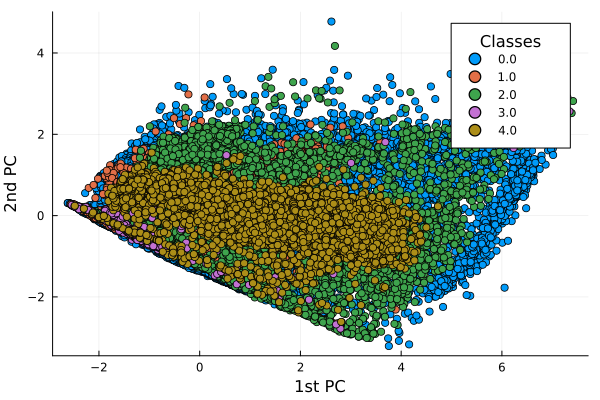

In [12]:
proj = evecs[:, 1:2]' * (X .- m)
Plots.scatter(proj[1,:], proj[2,:], group=y, legendtitle="Classes", legend=:topright, xlabel="1st PC", ylabel="2nd PC")

Check the composition of the first and second eigenvector...

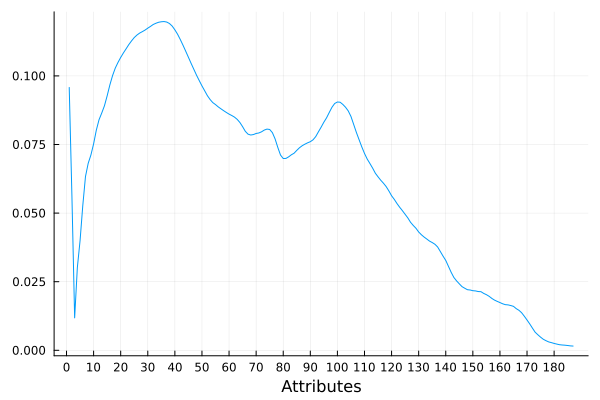

In [13]:
Plots.plot(1:187, abs.(evecs[:,1]), xlabel="Attributes", label="", xticks = 0:10:187)

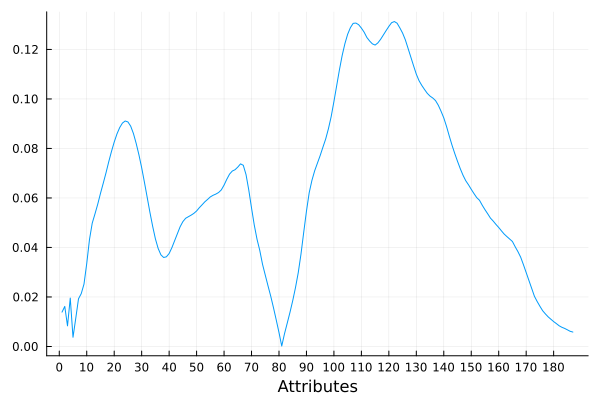

In [14]:
Plots.plot(1:187, abs.(evecs[:,2]), xlabel="Attributes", label="", legend=:topleft, xticks = 0:10:187)

Extract samples by class

In [15]:
class_0 = df[df[:,188] .== 0.0, :]
class_1 = df[df[:,188] .== 1.0, :]
class_2 = df[df[:,188] .== 2.0, :]
class_3 = df[df[:,188] .== 3.0, :]
class_4 = df[df[:,188] .== 4.0, :]

,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.71261,0.629032,0.527859,0.414956,0.284457,0.164223,0.0806452,0.0322581
2,1.0,0.484848,0.541667,0.526515,0.522727,0.507576,0.496212,0.412879
3,0.584046,0.5,0.424501,0.324786,0.233618,0.128205,0.0498575,0.0
4,1.0,0.93617,0.878598,0.813517,0.727159,0.607009,0.496871,0.365457
5,0.680412,0.584192,0.491409,0.379725,0.269759,0.149485,0.0721649,0.0120275
6,0.679105,0.61194,0.503731,0.324627,0.19403,0.212687,0.16791,0.0820896
7,0.69783,0.577629,0.459098,0.322204,0.198664,0.118531,0.0567613,0.033389
8,0.943128,0.8594,0.823065,0.734597,0.666667,0.505529,0.369668,0.259084
9,0.930825,0.882282,0.813107,0.741505,0.637136,0.527913,0.379854,0.235437


Plot the mean values of each class and visualise them in a line plot

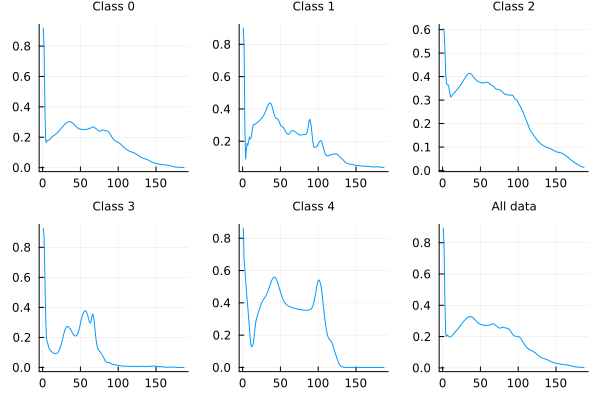

In [16]:
using Statistics
m_class_0 = Matrix(class_0)[:, 1:end-1]
m_class_1 = Matrix(class_1)[:, 1:end-1]
m_class_2 = Matrix(class_2)[:, 1:end-1]
m_class_3 = Matrix(class_3)[:, 1:end-1]
m_class_4 = Matrix(class_4)[:, 1:end-1]
avg_class_0 = mean(m_class_0, dims=1)
avg_class_1 = mean(m_class_1, dims=1)
avg_class_2 = mean(m_class_2, dims=1)
avg_class_3 = mean(m_class_3, dims=1)
avg_class_4 = mean(m_class_4, dims=1)
p1 = Plots.plot(1:187, vec(avg_class_0), label="", title="Class 0", titlefont = font(8))
p2 = Plots.plot(1:187, vec(avg_class_1), label="", title="Class 1", titlefont = font(8))
p3 = Plots.plot(1:187, vec(avg_class_2), label="", title="Class 2", titlefont = font(8))
p4 = Plots.plot(1:187, vec(avg_class_3), label="", title="Class 3", titlefont = font(8))
p5 = Plots.plot(1:187, vec(avg_class_4), label="", title="Class 4", titlefont = font(8))
p6 = Plots.plot(1:187, vec(m), label="", title="All data", titlefont = font(8))
Plots.plot(p1, p2, p3, p4, p5, p6, layout=6)

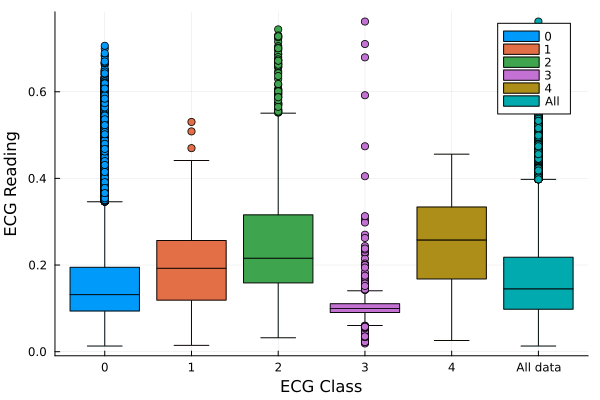

In [17]:
using StatsPlots
class_0_mean = mean(m_class_0, dims=2)
class_1_mean = mean(m_class_1, dims=2)
class_2_mean = mean(m_class_2, dims=2)
class_3_mean = mean(m_class_3, dims=2)
class_4_mean = mean(m_class_4, dims=2)
data_mean = mean(data, dims=2)
boxplot(class_0_mean, xlab="ECG Class", ylab="ECG Reading", label = "0", xticks = ([1:1:6;], ["0", "1", "2", "3", "4", "All data"]))
boxplot!(class_1_mean, label = "1")
boxplot!(class_2_mean, label = "2")
boxplot!(class_3_mean, label = "3")
boxplot!(class_4_mean, label = "4")
boxplot!(data_mean, label = "All")

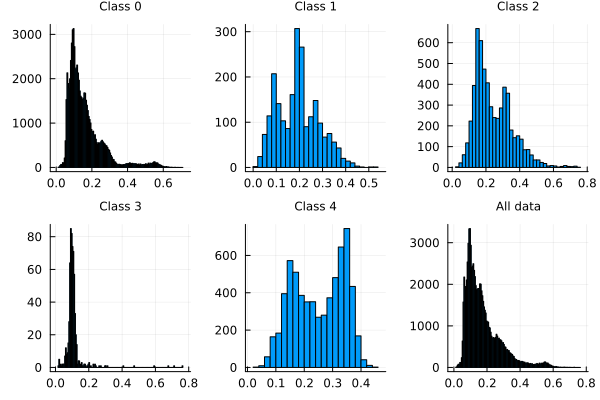

In [18]:
h1 = Plots.histogram(class_0_mean, title="Class 0", label="", titlefont = font(8))
h2 = Plots.histogram(class_1_mean, title="Class 1", label="", titlefont = font(8))
h3 = Plots.histogram(class_2_mean, title="Class 2", label="", titlefont = font(8))
h4 = Plots.histogram(class_3_mean, title="Class 3", label="", titlefont = font(8))
h5 = Plots.histogram(class_4_mean, title="Class 4", label="", titlefont = font(8))
h6 = Plots.histogram(data_mean, title="All data", label="", titlefont = font(8))
Plots.plot(h1, h2, h3, h4, h5, h6, layout=grid(2,3, heights=[0.5, 0.5, 0.5, 0.5]))

In [19]:
using MLJ
# import Pkg; Pkg.add("DecisionTree")
# Pkg.add("MLJDecisionTreeInterface")
Tree = @load DecisionTreeClassifier pkg=DecisionTree
tree = Tree()

┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\Megan Alejo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


import MLJDecisionTreeInterface

 ✔


DecisionTreeClassifier(
  max_depth = -1, 
  min_samples_leaf = 1, 
  min_samples_split = 2, 
  min_purity_increase = 0.0, 
  n_subfeatures = 0, 
  post_prune = false, 
  merge_purity_threshold = 1.0, 
  display_depth = 5, 
  feature_importance = :impurity, 
  rng = Random._GLOBAL_RNG())

In [34]:
tr_inds = partition(1:nrows(X), 0.99, shuffle=true)
y, X = unpack(df, ==(:Column188))

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0], 87554×187 DataFrame
   Row │ Column1   Column2   Column3   Column4    Column5    Column6    Column ⋯
       │ Float64   Float64   Float64   Float64    Float64    Float64    Float6 ⋯
───────┼────────────────────────────────────────────────────────────────────────
     1 │ 0.977941  0.926471  0.681373  0.245098   0.154412   0.191176   0.1519 ⋯
     2 │ 0.960114  0.863248  0.461538  0.196581   0.0940171  0.125356   0.0997
     3 │ 1.0       0.659459  0.186486  0.0702703  0.0702703  0.0594595  0.0567
     4 │ 0.925414  0.665746  0.541436  0.276243   0.196133   0.0773481  0.0718
     5 │ 0.967136  1.0       0.830986  0.586854   0.356808   0.248826   0.1455 ⋯
     6 │ 0.927461  1.0       0.626943  0.193437   0.0949914  0.0725389  0.0431
     7 │ 0.423611  0.791667  1.0       0.256944   0.0        0.277778   0.4652
     8 │ 0.716814  0.539823  0.283186  0.129794   0.0648968  0.0766962  0.

In [46]:
# import Pkg; Pkg.add("MLJBase")
using MLJBase
using ScikitLearn: fit!
mach = machine(tree, X, y)
fit!(mach, rows=tr_inds)

┌ Warning: The number and/or types of data arguments do not match what the specified model
│ supports. Suppress this type check by specifying `scitype_check_level=0`.
│ 
│ Run `@doc DecisionTree.DecisionTreeClassifier` to learn more about your model's requirements.
│ 
│ Commonly, but non exclusively, supervised models are constructed using the syntax
│ `machine(model, X, y)` or `machine(model, X, y, w)` while most other models are
│ constructed with `machine(model, X)`.  Here `X` are features, `y` a target, and `w`
│ sample or class weights.
│ 
│ In general, data in `machine(model, data...)` is expected to satisfy
│ 
│     scitype(data) <: MLJ.fit_data_scitype(model)
│ 
│ In the present case:
│ 
│ scitype(data) = Tuple{Table{AbstractVector{Continuous}}, AbstractVector{Continuous}}
│ 
│ fit_data_scitype(model) = Tuple{Table{<:Union{AbstractVector{<:Continuous}, AbstractVector{<:Count}, AbstractVector{<:OrderedFactor}}}, AbstractVector{<:Finite}}
└ @ MLJBase C:\Users\Megan Alejo\.julia\p

MethodError: MethodError: no method matching fit!(::Machine{MLJDecisionTreeInterface.DecisionTreeClassifier, true}; rows=([32324, 79492, 58947, 39363, 28408, 61525, 34407, 6052, 62062, 55448  …  26897, 65780, 61295, 61891, 84938, 27209, 80781, 68769, 46682, 50222], [72251, 58394, 9231, 55956, 68185, 86086, 39316, 37602, 20542, 83765  …  63833, 57584, 38462, 19314, 49982, 75184, 6104, 57831, 37207, 23633]))
Closest candidates are:
  fit!(!Matched::Union{LIBSVM.AbstractSVC, LIBSVM.AbstractSVR}, !Matched::AbstractMatrix) at C:\Users\Megan Alejo\.julia\packages\LIBSVM\IZl0L\src\ScikitLearnAPI.jl:68 got unsupported keyword argument "rows"
  fit!(!Matched::Union{LIBSVM.AbstractSVC, LIBSVM.AbstractSVR}, !Matched::AbstractMatrix, !Matched::AbstractVector) at C:\Users\Megan Alejo\.julia\packages\LIBSVM\IZl0L\src\ScikitLearnAPI.jl:68 got unsupported keyword argument "rows"
  fit!(!Matched::ScikitLearn.Models.LinearRegression, !Matched::AbstractArray{XT}, !Matched::AbstractArray{yT}) where {XT, yT} at C:\Users\Megan Alejo\.julia\packages\ScikitLearn\ssekP\src\models\linear_regression.jl:27 got unsupported keyword argument "rows"
  ...

In [40]:
ypred = predict_mode(mach, rows=tr_inds)
accuracy(ypred, y[tr_inds])

UndefRefError: UndefRefError: access to undefined reference

In [41]:
import Pkg; Pkg.add("MLJLIBSVMInterface")
import Pkg; Pkg.add("LIBSVM")

    Updating registry at `C:\Users\Megan Alejo\.julia\registries\General.toml`
   Resolving package versions...


  No Changes to `C:\Users\Megan Alejo\.julia\environments\v1.8\Project.toml`
  No Changes to `C:\Users\Megan Alejo\.julia\environments\v1.8\Manifest.toml`


   Resolving package versions...


  No Changes to `C:\Users\Megan Alejo\.julia\environments\v1.8\Project.toml`
  No Changes to `C:\Users\Megan Alejo\.julia\environments\v1.8\Manifest.toml`

In [42]:
# import Pkg; Pkg.add("MLJ")
using MLJ, LIBSVM
SVC = @load SVC pkg=LIBSVM
@load SVC pkg=LIBSVM; 
svc_model = SVC(kernel=LIBSVM.Kernel.Polynomial, degree=Int32(3));

import MLJLIBSVMInterface

┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\Megan Alejo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


 ✔
import MLJLIBSVMInterface ✔


┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\Megan Alejo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


In [43]:
y, X = unpack(df, ==(:Column188))

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0, 4.0], 87554×187 DataFrame
   Row │ Column1   Column2   Column3   Column4    Column5    Column6    Column ⋯
       │ Float64   Float64   Float64   Float64    Float64    Float64    Float6 ⋯
───────┼────────────────────────────────────────────────────────────────────────
     1 │ 0.977941  0.926471  0.681373  0.245098   0.154412   0.191176   0.1519 ⋯
     2 │ 0.960114  0.863248  0.461538  0.196581   0.0940171  0.125356   0.0997
     3 │ 1.0       0.659459  0.186486  0.0702703  0.0702703  0.0594595  0.0567
     4 │ 0.925414  0.665746  0.541436  0.276243   0.196133   0.0773481  0.0718
     5 │ 0.967136  1.0       0.830986  0.586854   0.356808   0.248826   0.1455 ⋯
     6 │ 0.927461  1.0       0.626943  0.193437   0.0949914  0.0725389  0.0431
     7 │ 0.423611  0.791667  1.0       0.256944   0.0        0.277778   0.4652
     8 │ 0.716814  0.539823  0.283186  0.129794   0.0648968  0.0766962  0.

In [44]:
# data = Matrix(df)[:, 1:end-1]
using MLJ, LIBSVM
SVC = @load SVC pkg=LIBSVM
@load SVC pkg=LIBSVM; 
svc_model = SVC(kernel=LIBSVM.Kernel.Polynomial, degree=Int32(3));
svc_mach = machine(svc_model, X, y)
fit!(svc_mach, rows=tr_inds, verbosity=0)

import MLJLIBSVMInterface ✔
import MLJLIBSVMInterface ✔


┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\Megan Alejo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159
┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\Megan Alejo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


┌ Warning: The number and/or types of data arguments do not match what the specified model
│ supports. Suppress this type check by specifying `scitype_check_level=0`.
│ 
│ Run `@doc LIBSVM.SVC` to learn more about your model's requirements.
│ 
│ Commonly, but non exclusively, supervised models are constructed using the syntax
│ `machine(model, X, y)` or `machine(model, X, y, w)` while most other models are
│ constructed with `machine(model, X)`.  Here `X` are features, `y` a target, and `w`
│ sample or class weights.
│ 
│ In general, data in `machine(model, data...)` is expected to satisfy
│ 
│     scitype(data) <: MLJ.fit_data_scitype(model)
│ 
│ In the present case:
│ 
│ scitype(data) = Tuple{Table{AbstractVector{Continuous}}, AbstractVector{Continuous}}
│ 
│ fit_data_scitype(model) = Union{Tuple{Table{<:AbstractVector{<:Continuous}}, AbstractVector{<:Finite}}, Tuple{Table{<:AbstractVector{<:Continuous}}, AbstractVector{<:Finite}, AbstractDict{Finite, <:Union{Continuous, Count}}}}
└ 

MethodError: MethodError: no method matching fit!(::Machine{MLJLIBSVMInterface.SVC, true}; rows=([32324, 79492, 58947, 39363, 28408, 61525, 34407, 6052, 62062, 55448  …  26897, 65780, 61295, 61891, 84938, 27209, 80781, 68769, 46682, 50222], [72251, 58394, 9231, 55956, 68185, 86086, 39316, 37602, 20542, 83765  …  63833, 57584, 38462, 19314, 49982, 75184, 6104, 57831, 37207, 23633]), verbosity=0)
Closest candidates are:
  fit!(!Matched::Union{LIBSVM.AbstractSVC, LIBSVM.AbstractSVR}, !Matched::AbstractMatrix) at C:\Users\Megan Alejo\.julia\packages\LIBSVM\IZl0L\src\ScikitLearnAPI.jl:68 got unsupported keyword arguments "rows", "verbosity"
  fit!(!Matched::Union{LIBSVM.AbstractSVC, LIBSVM.AbstractSVR}, !Matched::AbstractMatrix, !Matched::AbstractVector) at C:\Users\Megan Alejo\.julia\packages\LIBSVM\IZl0L\src\ScikitLearnAPI.jl:68 got unsupported keyword arguments "rows", "verbosity"
  fit!(!Matched::ScikitLearn.Models.LinearRegression, !Matched::AbstractArray{XT}, !Matched::AbstractArray{yT}) where {XT, yT} at C:\Users\Megan Alejo\.julia\packages\ScikitLearn\ssekP\src\models\linear_regression.jl:27 got unsupported keyword arguments "rows", "verbosity"
  ...